Osnabrück University - Computer Vision (Winter Term 2021/22) - Prof. Dr.-Ing. G. Heidemann, Ulf Krumnack, Axel Schaffland

# Exercise Sheet 8: Recognition 

## Introduction

This week's sheet should be solved and handed in before the end of **Tuesday, January 18, 2022**. If you need help (and Google and other resources were not enough), feel free to contact your groups' designated tutor or whomever of us you run into first. Please upload your results to your group's Stud.IP folder.

## Exercise 0: Math recap (Covariance) [0 Points]

This exercise is supposed to be very easy, does not give any points, and is voluntary. There will be a similar exercise on every sheet. It is intended to revise some basic mathematical notions that are assumed throughout this class and to allow you to check if you are comfortable with them. Usually you should have no problem to answer these questions offhand, but if you feel unsure, this is a good time to look them up again. You are always welcome to discuss questions with the tutors or in the practice session. Also, if you have a (math) topic you would like to recap, please let us know.

**a)** What does *covariance* express?

YOUR ANSWER HERE

**b)** Provide a formula to compute the covariance of two 1-dimensional datasets. How can it be generalized to the $n$-dimensional case?

YOUR ANSWER HERE

**c)** Create and plot two (1-dimensional) datasets with low covariance (use `plt.scatter`). Then do the same for two datasets with high covariance.

In [3]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

# YOUR CODE HERE

## Exercise 1: Template Matching Theory [2 points]

**a)** Explain in your own words the idea of *template matching*. Is it a data or model based approach? What are the advantages and disadvantages? In what situations would you apply template matching?

YOUR ANSWER HERE  
Template matching is used to detect certain structures in pictures with the help of a template image (that has the structure) and locates that image in a larger image. A certain image which is simplifying the original image, more precisely the structure to detect, is a template moved over the picture row for row. However, no convolution is computed, rather the similarity between image and template is computed producing a similarity map. It also may have problems with more complex shapes and not recognize them. Template matching can be considered a model based approach if we consider the template as a model. Nevertheless, it can also be considered a data based approach since the search is effectuated with data points that have to be searched in the image. The approach is not robust against scaling grey values. It has been applied in fields like face recognition, counting the number of faces that walk across part of a bridge within a certain amount of time, and medical image processing, by automated calcified nodule detection. You would apply template matching if you want to detect simple structures very fast.

**b)** Explain the ideas of *mean absolute difference* and *correlation coefficient*. Name pros and cons.

YOUR ANSWER HERE  
Both the mean absolute difference and the correlation coefficient are used in template matching and aim to provide a way to find the part of the image that most closely resembles the template, so they are both similarity measures. The idea of the mean absolute difference is to compute the mean difference of the gray values. The approach depends on shape and on absolute gray values. It is advantageous that it is robust against rotation and noise.
The Correlation coefficient is only depending on shape which is ideal. But to use this technique it is necessary that the template be normalized to have a mean of 0, so that the correlation can be computed using convolution. For large images the Fourier transform can be used to speed up the convolution.

## Exercise 2: Template Matching Practice: Where is Waldo [2 points]

In the two images `wheresWaldo1.jpg` and `wheresWaldo2.jpg`, Waldo is hiding in the midst of a busy crowd. He always wears the same red and white striped sweater and hat. However, he may be carrying a something that varies from scene to scene. Use template matching with the given Waldo templates (`waldo*.jpg`) to locate Waldo. Highlight
Waldo in the scene and indicate which template was matched.

**Hints:**
* You may use buildin functions to solve this exercise. E.g `skimage.feature.match_template` or `cv2.matchTemplate`
* The images are quite large! You may start by testing your code on a small image patch before applying it to the full scene.
* You may not achieve a perfect match. Analyse the problems you encounter and think how you can improve your result.

<Figure size 432x288 with 0 Axes>

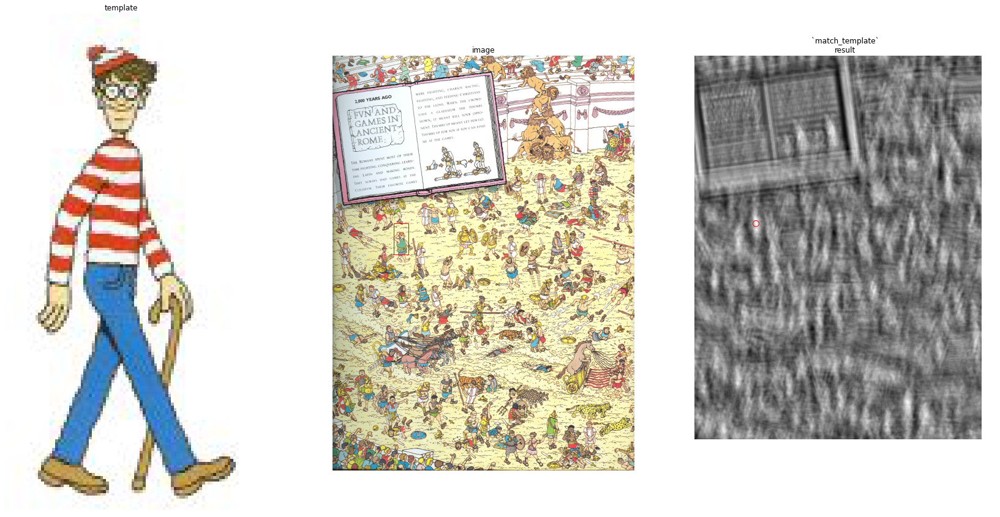

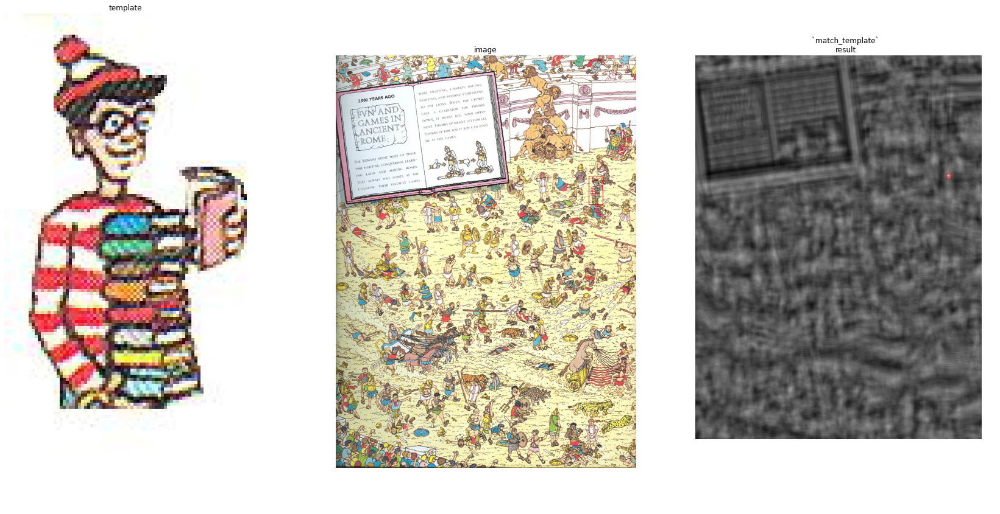

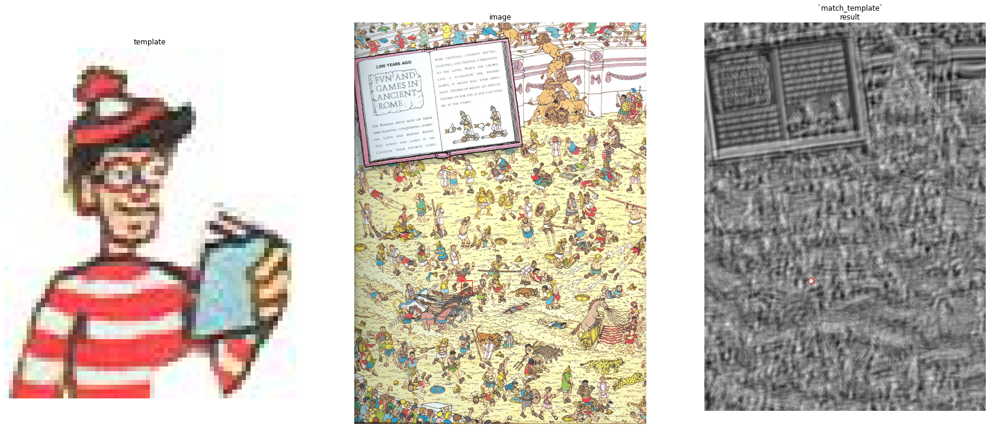

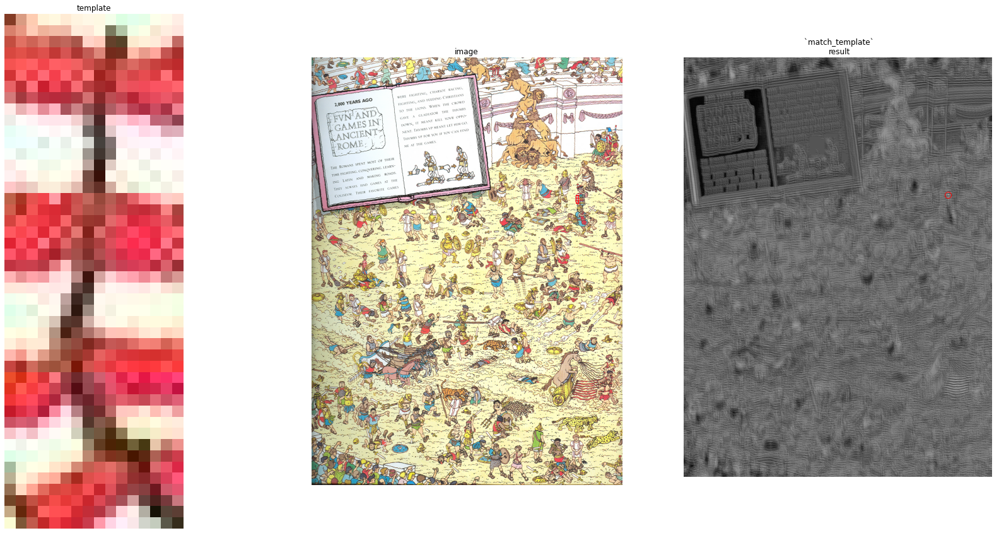

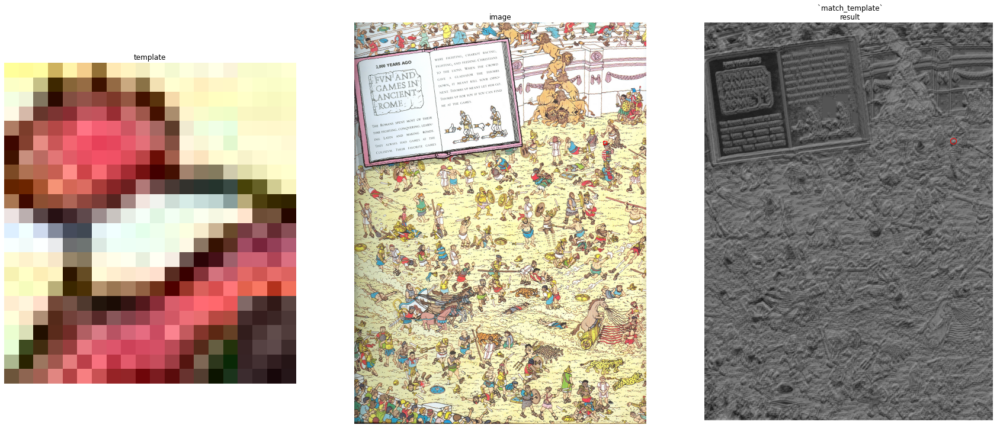

...

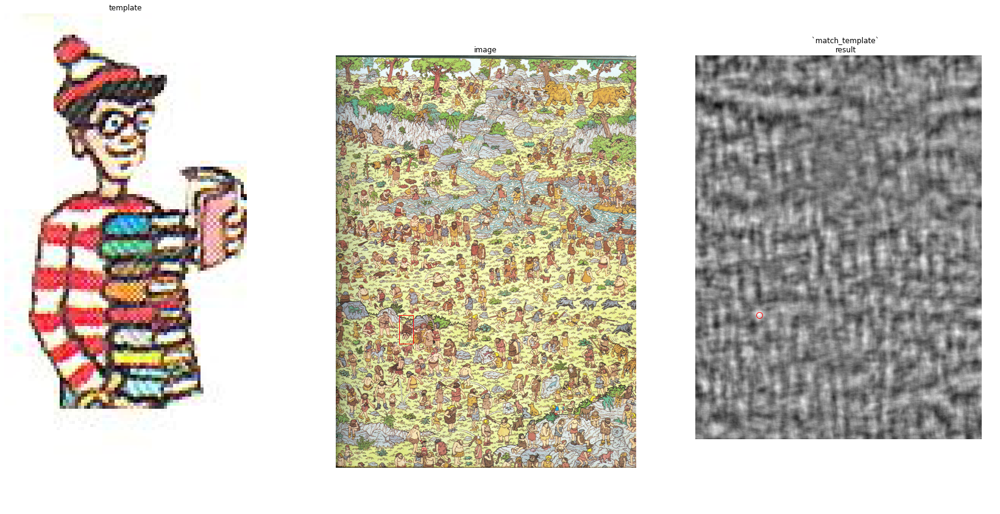

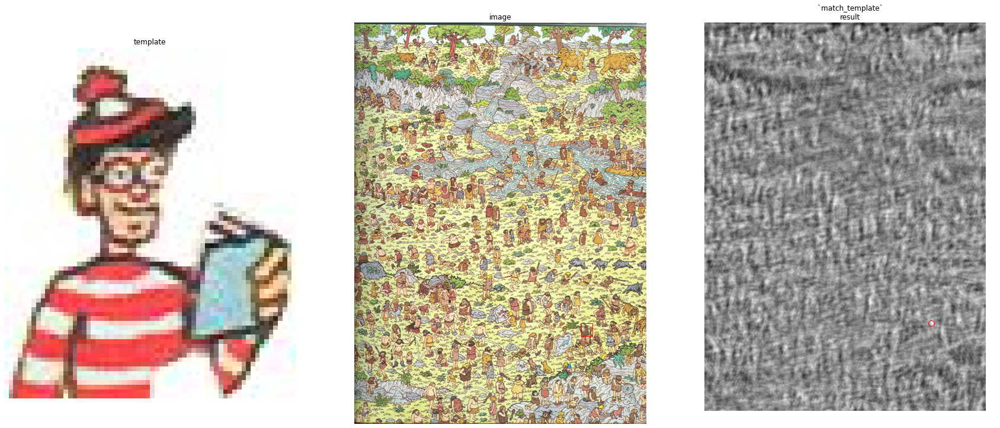

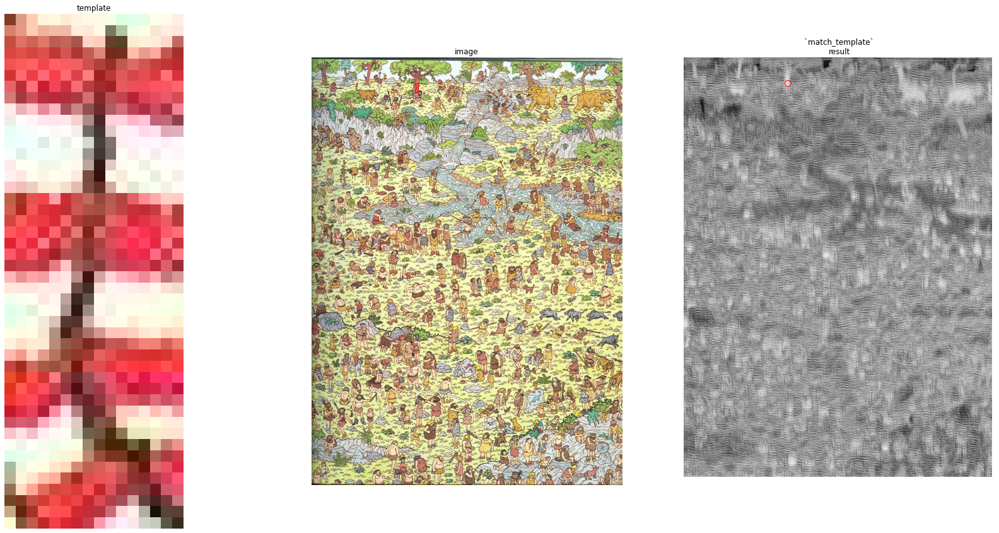

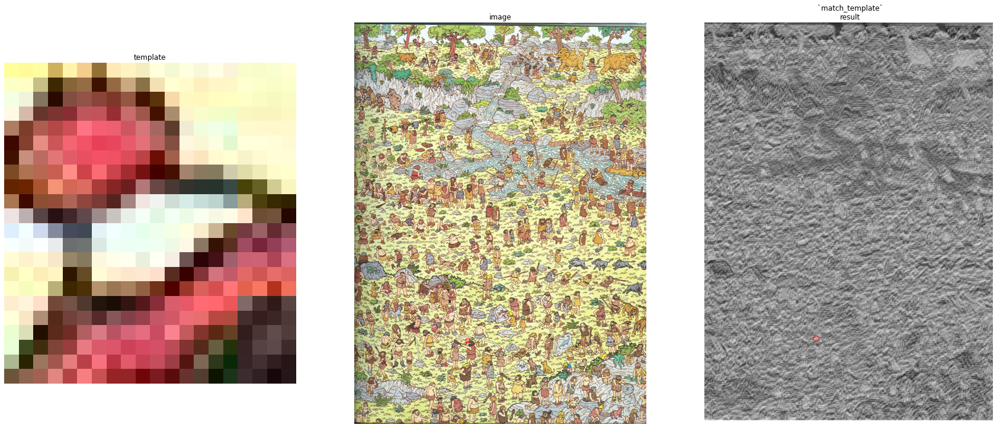

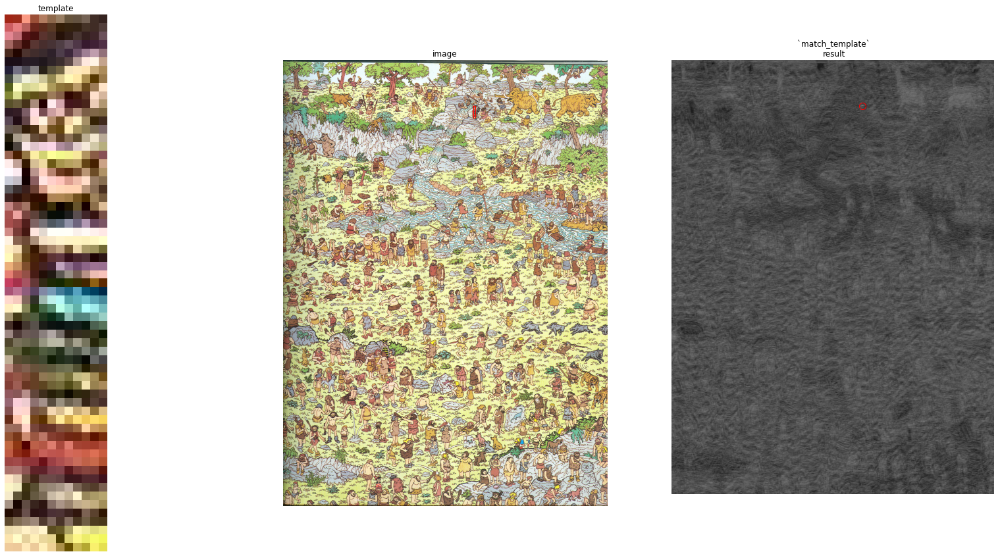

In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import match_template
waldos = [plt.imread('images/waldo/wheresWaldo{}.jpg'.format(i)) for i in range(1, 3)]
templates = [plt.imread('images/waldo/waldo{}.jpg'.format(i)) for i in range(0, 6)]    
    
# YOUR CODE HERE
plt.gray()
for image in waldos:
    for template in templates:
        result = match_template(image, template)
        ij = np.unravel_index(np.argmax(result), result.shape)
        _, x, y = ij[::-1]

        fig = plt.figure(figsize=(30, 15))
        ax1 = plt.subplot(1, 3, 1)
        ax2 = plt.subplot(1, 3, 2)
        ax3 = plt.subplot(1, 3, 3, sharex=ax2, sharey=ax2)
        
        
        # template single waldos 
        ax1.imshow(template, cmap=plt.cm.gray)
        ax1.set_axis_off()
        ax1.set_title('template')

        # images where waldo is searched
        ax2.imshow(image, cmap=plt.cm.gray)
        ax2.set_axis_off()
        ax2.set_title('image')
        
        # highlight matched region
        htemplate, wtemplate, _ = template.shape
        rect = plt.Rectangle((x, y), wtemplate, htemplate, edgecolor='r', facecolor='none')
        ax2.add_patch(rect)

        # result from template matching
        ax3.imshow(result)
        ax3.set_axis_off()
        ax3.set_title('`match_template`\nresult')
        
        # highlight matched region
        ax3.autoscale(False)
        ax3.plot(x, y, 'o', markeredgecolor='r', markerfacecolor='none', markersize=10)

        plt.show()


## Exercise 3: Pattern Recognition and PCA [4 points]

**a)** What are the goals of *pattern recognition*? How can they be achieved? What are the problems?

YOUR ANSWER HERE  
Pattern recognition aims to convert signals to symbols and recognition of patterns and regularities in data. Its goal is to  obtain a symbolic description from the based on the signal / sensor data. There are certain steps related to pattern recognition such as feature extraction and classification. The features are meant to be extracted in a way such that it supports the classification task. Additionally, more important than a good classifier are good features such as fulfilling requirements of discrimination, reduced redundancy and robustness concerning significant changes of the signal. Mapping the signals to symbols can be quite complex. Indicators like distance, robustness, variation and abstraction are directly connected to the complexity of conversion. Generally, mapping the signal to symbols is the more difficult the less similar the “neighbourhoods” of signals are to those of the symbols. Problems arise if those criteria are not fulfilled properly, it is getting more complex. 

**b)** What is *principal component analysis*? How is it related to pattern recognition?

YOUR ANSWER HERE  
By and large, the idea of PCA is simple — reduce the number of variables of a data set, while preserving as much information as possible. It is a linear dimensionality reduction method that works by approximating a d-dimensional data-representation using m < d orthogonal vectors which are oriented in the directions of maximal variance. It is a technique that is used in pattern recognition.

**c)** Explain how principal components can be computed? Then implement a function that performs the computation.

YOUR ANSWER HERE  
To compute principal components one first needs to get the covariance matrix of the data, then calculate the eigenvectors and eigenvalues. The eigenvectors are the principal components with the largest eigenvalues.

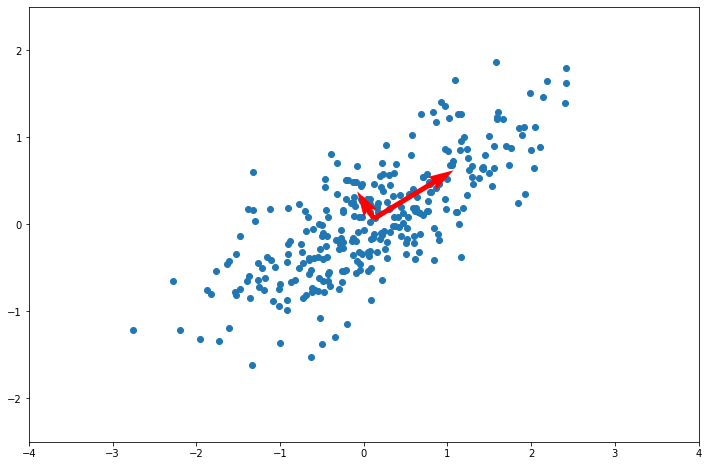

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np


def pca(data):
    """
    Perform principal component analysis.
    
    Args:
        data (ndarray): an array of shape (n,k),
        meaning n entries with k dimensions
        
    Returns: two arrays
        pc (ndarray): array of shape (k,k) holding the principal components in its columns.
        var (ndarray): k-vector holding the corresponding variances, in descending order.
    """
    
    # Replace the following two lines by your code ...
    # YOUR CODE HERE
    data = data.T
    
    covar = np.cov(data)
    eigenval, eigenvec = np.linalg.eig(covar)

    pc = eigenvec
    var = eigenval    
    return pc, var

# generate some random data
np.random.seed(23)
data = np.random.multivariate_normal([0,0], cov = [[1, .55], [.55, .5]], size=300)

# compute the principal components
pc, var = pca(data)
mean = data.mean(axis=0)

# plot the results
plt.figure(figsize=(12,8))
plt.xlim(-4,4)
plt.ylim(-2.5,2.5)
plt.scatter(*data.T)
plt.quiver(*mean[np.newaxis].repeat(2,axis=0).T, *(np.sqrt(var)*pc), color='red', scale=1, scale_units='xy')
plt.show()

# sanity check
assert np.allclose(var, [1.216, 0.137], rtol=1e-3)

## Exercise 4: Eigenfaces [6 points]

**a)** Import the images from the directory `images/trainimgs` into an numpy array using the function 
`read_images_from_directory` provided in the cell below. Display the images and the corresponding names.

In [ ]:
%matplotlib inline
import sys
import os
import glob
import numpy as np
import matplotlib.pyplot as plt

def read_images_from_directory(directory, suffix, shape):
    """
    Read all images found in DIRECTORY with given file
    name SUFFIX. All images should have the same SHAPE,
    specified as (rows,columns).
    
    Args:
        directory (string): Name of input directory.
        suffix (string): File type suffix.
        shape (tuple): Shape of images to be loaded.
    
    Returns:
        images (ndarray): A numpy array of shape m*rows*columns (from shape)
        names (list): A list of corresponding image names.
    """

    # initialize the image array and name list
    #images = np.empty((0, *shape))
    images = np.empty((0, ) + shape)
    names = []
    
    files = glob.glob(directory + os.sep + '*.' + suffix)
    files.sort()
    # now loop through all image files in the directory
    for file_name in files:
        if os.path.isfile(file_name):

            # load each image (as double)
            img = plt.imread(file_name)

            # check for correct size
            if img.shape == shape:
                images = np.append(images, img.reshape((1, ) + shape), axis=0)
                names.append(os.path.basename(file_name))
            else:
                print(
                    'warning: Image "' + file_name +
                    '" with wrong size will be ignored!',
                    file=sys.stderr)

    return images, names


# image file suffix
suffix = 'pgm'

# image size
img_shape = (192, 168)

# YOUR CODE HERE
imgs, names = read_images_from_directory('images/trainimg', suffix, img_shape)
plt.figure(figsize=(20, 20)); plt.gray()

for i, (img, name) in enumerate(zip(imgs, names)):
    plt.subplot(5, 4, i+1); plt.axis('off'); plt.imshow(img); plt.title(name[5:7])
    

plt.show()

**b)** Use PCA to compute the eigenfaces (i.e. the eigenvectors of the face images). You may use your PCA function from Exercise 1c or some build in function. Explain what kind of input PCA expects, and how that fits to our images (you may have to `reshape` the images!). Finally, display the eigenfaces.

In [ ]:
# YOUR CODE HERE
from sklearn.decomposition import PCA

n_samples, h, w = imgs.shape
pca = PCA()

# expects: Xarray-like of shape (n_samples, n_features)
#          Training data, where n_samples is the number of samples and n_features is the number of features.

train = imgs.reshape(n_samples, h*w)
pca.fit(train)
eigenfaces = pca.components_

plt.figure(figsize=(20, 20)); plt.gray()
for i, img in enumerate(eigenfaces.reshape((n_samples, h, w))):
    plt.subplot(5, 4, i+1); plt.axis('off'); plt.imshow(img)
    
plt.show()


**c)** Now project the training face images into the eigenspace to calculate their ”feature vectors”,
i.e. a representation with significantly lower dimension. For the projection of the face images,
they have to be centered first, i.e. the mean face vector has to be subtracted. Store the mean face in some vector (`mean_face`) and the representation achieved in some array (`face_db`). Finally restore the images from `face_db` and display them alongside the original image. Try out the effect of changing the number of eigenfaces to be used (`num_eigenfaces`).

In [ ]:
# number of eigenfaces to be used
from sklearn.decomposition import PCA
num_eigenfaces = 19

# Remark: a value of 20 (theoretical perfect reconstruction) may suffer from numerical
# instability (the last eigenface may introduce noise).
# However, a value of 19 suffices for almost perfect reconstruction ...


# YOUR CODE HERE
n_samples, h, w = imgs.shape
mean_face = np.mean(imgs, axis=0)

centered = imgs-mean_face
pca = PCA(num_eigenfaces)
train = centered.reshape(n_samples, h*w)
pca.fit(train)
eigenfaces = pca.components_

plt.figure(figsize=(20, 20)); plt.gray()
for i, img in enumerate(eigenfaces.reshape((num_eigenfaces, h, w))):
    plt.subplot(5, 4, i+1); plt.axis('off'); plt.imshow(img)
    
plt.show()

face_db = pca.transform(train)
t = pca.inverse_transform(face_db)
result = t.reshape(n_samples, h, w) + mean_face

plt.figure(figsize=(20, 20)); plt.gray()
for i, img in enumerate(result):
    plt.subplot(5, 4, i+1); plt.axis('off'); plt.imshow(img)
    
plt.show()

**d)** Understand the function `recognize_face` that recognizes a face from that database by calculating the euclidean distance of this face feature vector to all of the training feature vectors from the database. The feature vector with the smallest distance represents the winner category. Check the implementation by recognizing the images from the training set (they should be recognized without error).

In [ ]:
train_imgs= imgs
train_names = names
mean_face = mean_face.flatten()
eigenfaces_used = eigenfaces

In [ ]:
from scipy.spatial.distance import cdist

def recognize_face(face, eigenfaces, mean_face, face_db):
    """
    Recognize a face from a face database.
    and return the index of the best matching database entry.

    The FACE is first centered and projected into the eigeface
    space provided by EIGENFACES. Then the best match is found
    according to the euclidean distance in the eigenface space.
    
    Args:
        face (ndarray): Face to be recognised.
        eigenfaces (ndarray): Array of eigenfaces.
        mean_face (ndarray): Average face.
        face_db (ndarray): Database of faces projectected into Eigenface space.
        
    Returns:
        index (uint): Position of the best matching face in face_db.
    """
    index = -1


    # center the face
    centered = face - mean_face

    # and project it into the eigenface space
    projected = eigenfaces @ centered

    # Now compute the similarity to all known faces
    # (comparison is performed in the eigenface space)
    distances = cdist(face_db, projected[None, :])
    index = distances.argmin()



    return index


# ... and now check the function on the training set ...
def show_recognition_results(imgs, labels, train_imgs, train_labels,
                             num_eigenfaces, eigenfaces, mean_face, face_db):
    """Iterate over all face images and compute the best matching face in face_db.
    
    Args:
        imgs (list): List of test faces.
        train_imgs (list): List of training faces.
        train_labels (list): List of training labels.
        num_eigenfaces (uint): Number of eigenfaces.
        eigenfaces (list): List of the eigenfaces.
        mean_face (ndarray): Average face.
        face_db (ndarray): Database of faces projectected into Eigenface space.
        
    Returns:
    
    """
    
    img_shape = imgs[0].shape
    plt.figure(figsize=(12, 12))
    plt.suptitle(
        'Face recognition based on {} principal components'.format(num_eigenfaces))
    plt.gray()
    for j, img in enumerate(imgs):

        # find the best match in the eigenface database
        winner = recognize_face(
            img.reshape(np.prod(img_shape)), eigenfaces, mean_face, face_db)
        name_label = labels[j][5:7]
        name_winner = train_labels[winner][5:7]

        plt.subplot(5, 8, 2 * j + 1)
        plt.axis('off')
        plt.imshow(img)
        plt.title(labels[j][5:7])

        plt.subplot(5, 8, 2 * j + 2)
        plt.axis('off')
        plt.imshow(train_imgs[winner])
        t = plt.title(('*' if name_label != name_winner else '') + name_winner)
        plt.setp(t, color='r' if name_label != name_winner else 'g') 
    plt.show()
    
show_recognition_results(train_imgs, train_names,
                         train_imgs, train_names,
                         num_eigenfaces, eigenfaces_used, 
                         mean_face, face_db)


**e)** Now classify the images in directory `images/testimg/`. Try to reduce the number of principal components
used. How many PCs are necessary to still achieve perfect classification?

In [ ]:
test_imgs, test_names = read_images_from_directory('images/testimg', suffix,
                                                   img_shape)

# YOUR CODE HERE
num_eigenfaces = 5

n_samples, h, w = imgs.shape
mean_face = np.mean(imgs, axis=0)

centered = imgs-mean_face

pca = PCA(num_eigenfaces)

train = centered.reshape(n_samples, h*w)
pca.fit(train)
eigenfaces = pca.components_

face_db = pca.transform(train)
t = pca.inverse_transform(face_db)
result = t.reshape(n_samples, h, w) + mean_face

train_imgs= imgs
train_names = names
mean_face = mean_face.flatten()
eigenfaces_used = eigenfaces



show_recognition_results(test_imgs, test_names,
                         train_imgs, train_names,
                         num_eigenfaces, eigenfaces_used, 
                         mean_face, face_db)

## Exercise 5: Understanding the Wireframe-Model [5 points]

This exercise addresses the matching procedure described on (CV-12 Model Based Recognition slides 9-17)

**a)** Explain in your own words the functions on slide  (CV-12 slide 9). Also explain when and why it may make sense to use $m$ instead of $m'$.


YOUR ANSWER HERE                                                                    
The first two functions are the x and y gradients, to calculate these the gray values of the following pixel in that axis is substracted from the value of the previous one.
$$x-gradient ∆_xg = g(x+1,y) − g(x−1,y)$$   
$$y-gradient ∆_yg = g(x,y+1) − g(x,y−1)$$  
m' then is just the gradient magnitude,
$$m'(x,y) = (∆_xg^2 + ∆_yg^2 )^{1/2}$$
and ß is the gradient orientation, for which the inverse tangent is taken of the division of the y and x gradients. One has to make sure to avoid a division of 0.
$$β(x,y) = arctan(∆_yg / ∆_xg)$$   
As m is just a thresholded version of m', it makes sense to use it to get rid of smaller, unimportant, magnitudes - we want to threshold the magnitude in order to find edge points - to reduce computation time as otherwise the fitness computations would be done for all gradients.  
$$m(x,y) = Θ(m'(x,y) − T)$$   

**b)** Explain the fitness score $E_{si}$ and $E_l$. What do the arrows (CV-12 slide 11), e.g. $\beta_j$ and $S_j$, indicate? What is the idea of $G(d)$?

YOUR ANSWER HERE  
$E_{S_i}$ is the fitness score for a single pixel withing the rectangle R around the line segment l that is currently evaluated. The score for a single pixel depends on its magnitude $m(x,y)$ and how well it fits to the line, meaning how close to perpendicular its gradient is to l. $sin(\beta (x,y) - \alpha)$ where $\beta$ is the gradient direction of $Si$ and $\alpha$ is the angle of the line. Fitness must be proportional to gradient magnitude.  
  
$E_{l}$ then is the fitness score the line segment l. It is calculated by taking taking the contributions, so the fitness scores, of all pixels in R which are weighted according to their distance to l with a gaussian G(d), which has a mean of 0 and sigma of the width of R.
The arrows on the slide indicate the gradient direction $\beta_j$ and the gradient respectively.

**c)** Explain the goal of EDA (Estimation of Distribution Algorithm) and how it is performed in the context of the matching procedure.

YOUR ANSWER HERE  
The goal of EDA is to use an evolutionary approach to optimize parameters. This is done by selecting good individuals (with high fitness scores), estimating the distribution from which these stem, and then sampling the next generation from this distribution. This is repeated until a stop condition is met. This ensures that new individuals are usually similar to the previous generation but also allows them to differ so that better parameters can be discovered without losing the progress already made.

## Exercise 6: Histogram of Oriented Gradients (HOG) [3 points]

The *Histogram of Oriented Gradients (HOG)* applied in the initial step of the wireframe matching procedure is also applied in other computer vision algorithms, especially in the context of object recognition. This exercise will examine this tool in a bit more detail.

**a)** Explain the idea of the histogram of oriented gradients. How can it be applied to analyze images? Think how this idea may be used to recognize objects?

YOUR ANSWER HERE  
Part of the idea of HOG is already obvious from the name, it takes the histogram of the gradient orientations, so it counts the occurences of the angles of the gradients which are weighted by the respective gradient magnitude, but importantly this is (usually) not done for the whole image but individually for small sections, called cells, of the image so that the result consists of many histograms - one for each image cell.
From this one can then easily extract the most prominent gradient direction for each cell, which might be useful in determining an objects orientation. Conventionally, one may also call HOG a feature descriptior because it focuses on the sturcture or shape of an object whereas it is using magnitude and angle of the gradient to compute the features.

**b)** The Scikit-image library provides the function [`hog`](https://scikit-image.org/docs/dev/auto_examples/features_detection/plot_hog.html) that can compute histograms of oriented gradients and offers also an option to construct a visualization. Run the following code cell and then describe your observations in the text cell below:

In [ ]:
%matplotlib notebook

import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage import data, exposure
from skimage.transform import resize
import numpy as np
import imageio

image = imageio.imread('./images/truck.jpeg')
image = resize(image,(700,1000),preserve_range=True).astype(np.uint8)

fd, hog_image = hog(image,feature_vector=False,visualize=True, multichannel=True)
#multichannel is depcricated starting from skimage 0.19.0, use channel_axis instead
#fd, hog_image = hog(image,feature_vector=False,visualize=True, channel_axis=2)

# Display the result
fig, (ax1, ax2, ax3) = plt.subplots(3,1, figsize=(8, 12))

ax1.axis('off')
ax1.imshow(image, cmap=plt.cm.gray)
ax1.set_title('Input image')

# Rescale histogram for better display
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

ax2.axis('off')
ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
ax2.set_title('Histogram of Oriented Gradients')
plt.show()

bars = ax3.bar(np.linspace(0,180,fd.shape[-1]),fd[0,0,0,0],width=(180/fd.shape[-1]))

plt.tight_layout()
plt.show()

def on_press(event):
    """Mouse button press event handler
    Args:
    event: The mouse event
    """
    x, y = int(event.xdata)//8, int(event.ydata)//8
    
    cell_x = x - fd.shape[1] if x >= fd.shape[1] else 0
    x = min(x,fd.shape[1]-1)
    cell_y = y - fd.shape[0] if y >= fd.shape[0] else 0
    y = min(y,fd.shape[0]-1)
    ax3.clear()
    ax3.set_title(f"x={x} [{cell_x}], y={y} [{cell_y}], {fd.shape}")
    ax3.bar(np.linspace(0,180,fd.shape[-1]),fd[y,x,cell_y,cell_x],width=(180/fd.shape[-1]))
    fig.canvas.draw()

cid = fig.canvas.mpl_connect('button_press_event', on_press)

YOUR ANSWER HERE 
The first image shows the input image, a truck where part of the background has beem replaced by a flat blue color. The second image displays the output of the hog function, and the last par plots the histogram of oriented gradients for the cell at the position of the click.

**c)** Implement your own version of the histogram of oriented gradients function. You may proceed in the following steps:
1. Compute the gradient image and determine magnitude and direction of gradients.
2. Divide the image into cells and compute a weighted histogram for each cell.
3. Use the function to [`plt.quiver`](https://matplotlib.org/api/_as_gen/matplotlib.pyplot.quiver.html) to display your results (already implemented).

In [ ]:
# Step 1: compute gradients

%matplotlib inline
import numpy as np
import imageio
import matplotlib.pyplot as plt
from skimage.color import rgb2gray
from skimage.filters import sobel_h, sobel_v


def image_gradients(image):
    """Compute graident magnitudes and directions for a given image.
    
    Input:
        image: an numpy.ndarray of shape (HEIGHT, WIDTH)
    Result:
        magnitude, direction: two numpy.ndarrays of the same shape as image,
        holding gradient magnitudes and directions, respectively.
    """    
    # YOUR CODE HERE
    g_x = sobel_h(image)
    g_y = sobel_v(image)
    magnitude = (g_x**2 + g_y**2)**(1/2)
    direction = np.arctan(g_y/g_x)
    return magnitude, direction

image = rgb2gray(imageio.imread('./images/car.png').astype(np.uint8))
magnitude, direction = image_gradients(image)

plt.figure(figsize=(12,6))
plt.gray()
plt.subplot(1,2,1); plt.title("Image")
plt.imshow(image)
plt.subplot(1,2,2); plt.title("Gradient magnitude")
plt.imshow(magnitude)
plt.show()

In [ ]:
# Step 2: compute the histograms

def histogram_of_oriented_gradients(image, cell_size=(16,16), bins=9):
    """Compute histograms of oriented gradients for an image.
    Input:
        image: image: an numpy.ndarray of shape (HEIGHT, WIDTH)
        cell_size: the size of individual cells into which the image is divided
        bins: the number of bins per histogram
    Result:
        An np.ndarray of shape (CELL_ROWS, CELL_COLUMNS, BINS) containing
        the histograms for the individual cells
    """
    # Hint: you may use np.histogram() here
    rows, columns = image.shape[0]//cell_size[0], image.shape[1]//cell_size[1]
    hog = np.zeros((rows, columns, bins))
    # YOUR CODE HERE
    magnitude, direction = image_gradients(image)
    direction = np.nan_to_num(direction)
   
    for row in range(rows):
        for column in range(columns):
            
            hist, _ = np.histogram(direction[row*cell_size[0]:(row+1)*cell_size[0], column*cell_size[0]:(column+1)*cell_size[0]], 
                                               bins=bins, 
                                               weights=magnitude[row*cell_size[0]:(row+1)*cell_size[0], column*cell_size[0]:(column+1)*cell_size[0]])
            hog[row, column, :] = hist
    
    return hog

hog = histogram_of_oriented_gradients(image)

In [ ]:
# Step 3: display your results

%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np

cell_size=(8,8)
hog = histogram_of_oriented_gradients(image, cell_size=cell_size)

plt.figure(figsize=(12,12))
plt.gca().set_aspect('equal')
plt.gca().invert_yaxis()

y, x = np.arange(hog.shape[0])*cell_size[0], np.arange(hog.shape[1])*cell_size[1]
for angle in range(hog.shape[-1]):
    rad = angle * np.pi / hog.shape[-1]
    u = hog[:,:,angle] * np.sin(rad)
    v = hog[:,:,angle] * np.cos(rad)
    plt.quiver(x,y,u,v,scale=200.)
    plt.quiver(x,y,-u,-v,scale=200.)

plt.show()